# Examples of using `pylabeladjust`
First we do some imports...

In [1]:
# Import standards:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import os
import tqdm
import shutil
import imageio
from IPython.display import Image, display



import textwrap # it wraps text! :)


# Import opinionated for nicer plots:
import opinionated
plt.style.use("opinionated_rc")
import colormaps as cmaps 

# Autoreload, for development:
%load_ext autoreload
%autoreload 2


# Import the pylabeladjust-functions:
from pylabeladjust import adjust_labels,adjust_texts,plot_rectangles




Now downloading: Roboto Condensed
Added new font as Roboto Condensed Light
Added new font as Roboto Condensed
Added new font as Roboto Condensed
Added new font as Roboto Condensed Black
Now downloading: Montserrat
Added new font as Montserrat Thin Light
Added new font as Montserrat Thin
Added new font as Montserrat Thin
Added new font as Montserrat Thin Black
Now downloading: Source Code Pro
Added new font as Source Code Pro ExtraLight Light
Added new font as Source Code Pro ExtraLight
Added new font as Source Code Pro ExtraLight
Added new font as Source Code Pro ExtraLight Black
Now downloading: Fira Sans
Added new font as Fira Sans Light
Added new font as Fira Sans
Added new font as Fira Sans
Added new font as Fira Sans Black
Now downloading: Fira Sans Condensed
Added new font as Fira Sans Condensed Light
Added new font as Fira Sans Condensed
Added new font as Fira Sans Condensed
Added new font as Fira Sans Condensed Black
Now downloading: IBM Plex Sans
Added new font as IBM Plex San

To show how 

In [97]:
data = pd.read_csv("data/EPSA23_example.csv")
display(data)

,Unnamed: 0,x,y,title,fontsize,fontweight
0,0,5.606269,7.490148,On probability theory,5.1,bold
1,1,5.617779,3.731517,The Nature of Research Environments,5.7,bold
2,2,5.327194,6.771035,Modalities In Scientific Representation,5.7,bold
3,3,5.788806,9.482959,A Categoricity Problem For Quantum Inferentialism,4.2,normal
4,4,5.689692,9.656334,Perspectivist Account of Truth-Theoretic Seman...,4.2,normal
...,...,...,...,...,...,...
190,190,4.746625,2.385326,"Discrimination, Measurement and Normative Theory",5.7,bold
191,191,5.259864,3.196076,Loving Science,4.2,normal
192,192,6.902723,4.990467,Literature Navigation Systems: An Epistemologi...,4.2,normal
193,193,6.407291,3.812750,What Makes Research Relevant?,4.2,normal


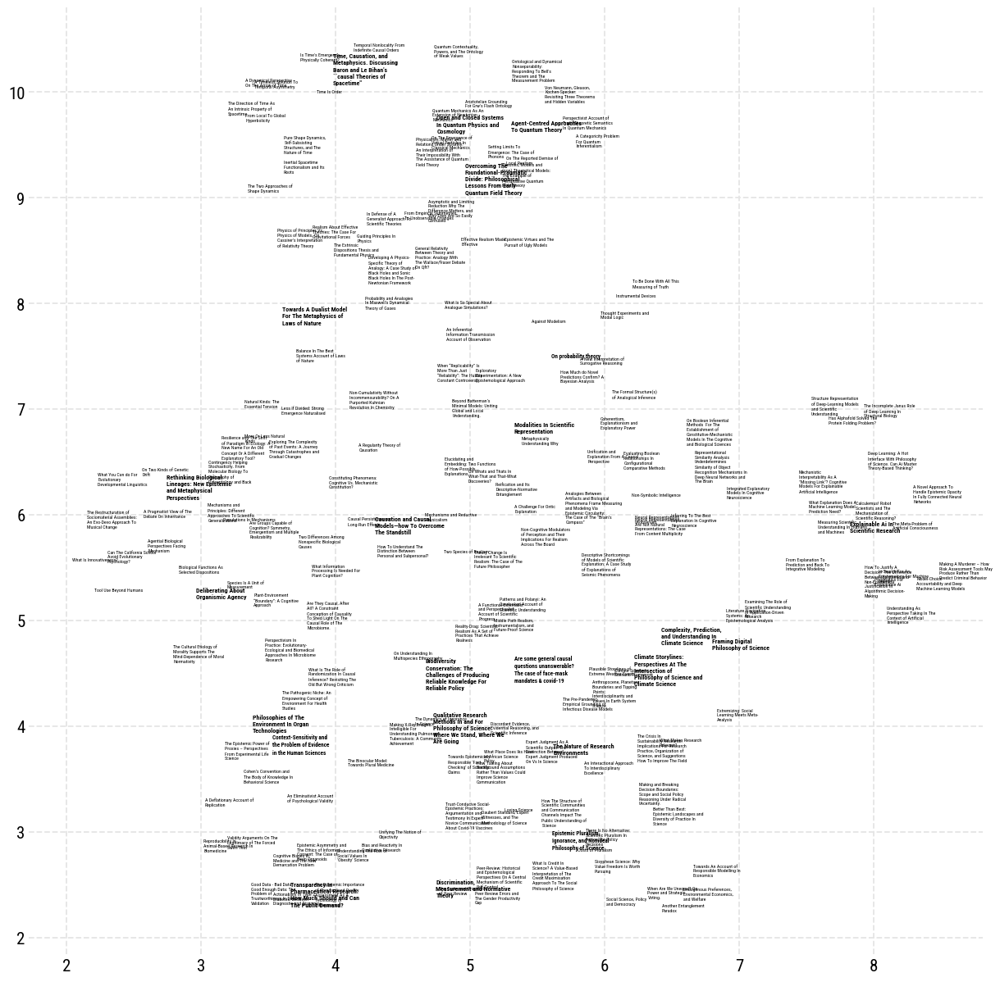

In [98]:
fig, ax = plt.subplots(figsize=(15, 15))
ax.scatter(data['x'], data['y'], s=20, alpha=.0, c='#a7510f')
texts = []
for i, row in data.iterrows():
    texts.append(ax.text(row['x'], row['y'], textwrap.fill(row['title'],25) , fontsize=row['fontsize'],ma='left',fontweight=row['fontweight'],zorder=10))
    

  0%|          | 0/500 [00:00<?, ?it/s]

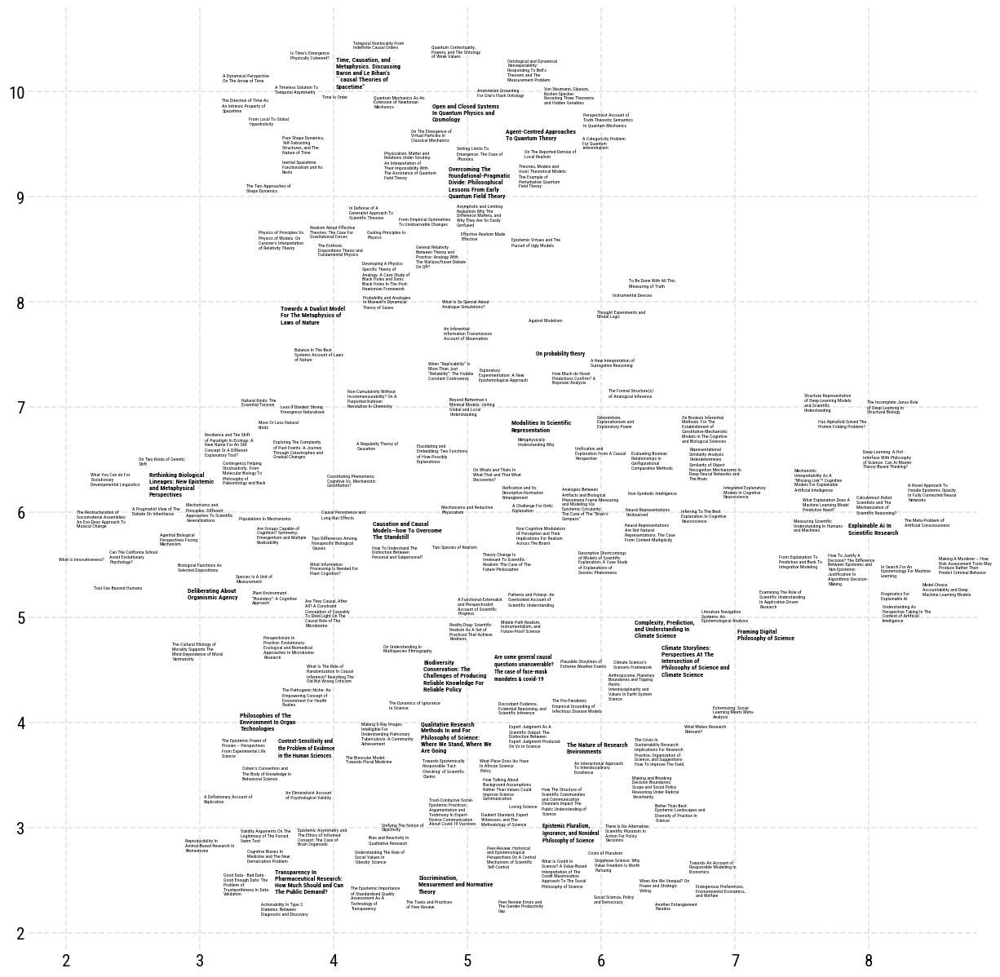

In [105]:
fig, ax = plt.subplots(figsize=(15, 15))
ax.scatter(data['x'], data['y'], s=20, alpha=.0, c='#a7510f')
texts = []
for i, row in data.iterrows():
    texts.append(ax.text(row['x'], row['y'], textwrap.fill(row['title'],25) , fontsize=row['fontsize'],ma='left',fontweight=row['fontweight'],zorder=10))
fig.canvas.draw()



        
rectangles_adjusted, optimization_progress_texts = adjust_texts(texts,speed=.03,max_iterations=500, adjust_by_size=True, margin_percentage=6,radius_scale=1.03, return_optimization_process=True)
plt.show()


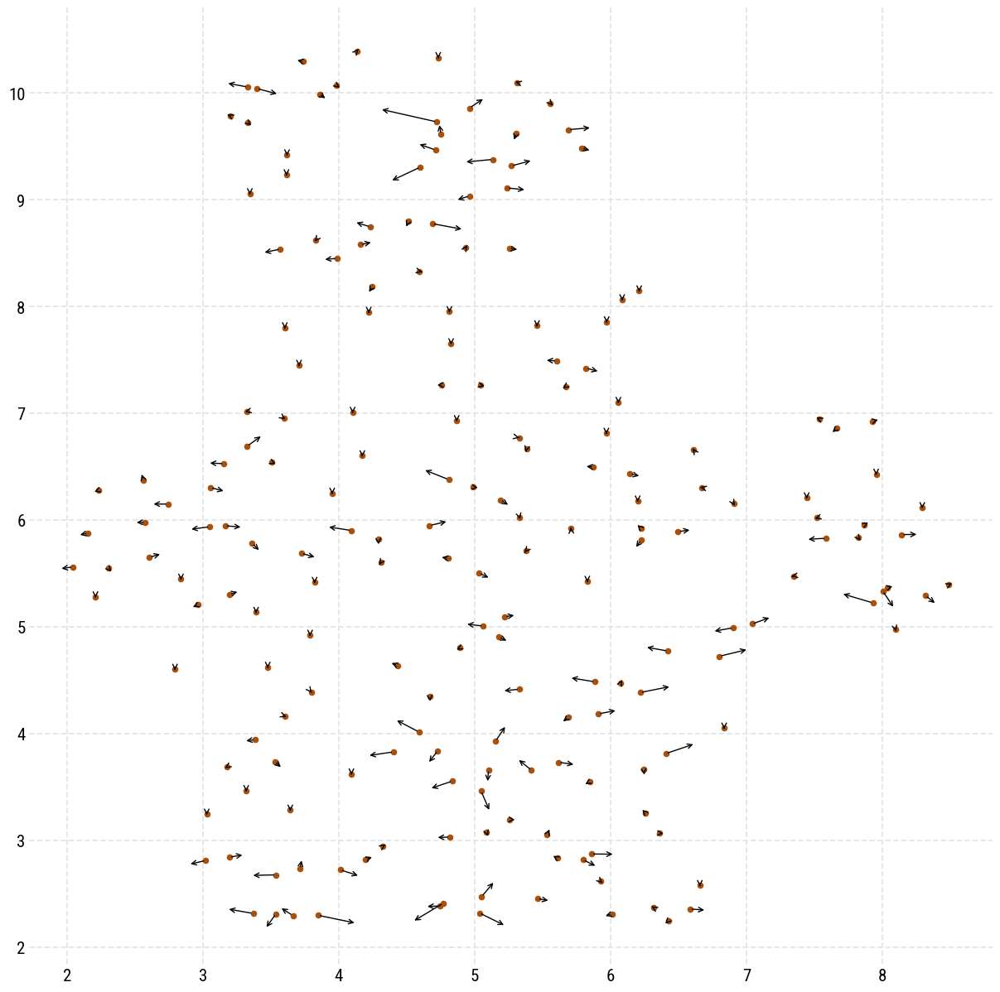

In [106]:
fig, ax = plt.subplots(figsize=(15, 15))
ax.scatter(data['x'], data['y'], s=20, alpha=1., c='#a7510f')

# Link rectangles with lines
# for i in range(len(data)):
#     plt.plot([data.loc[i, 'x'], rectangles_adjusted.loc[i, 'x']], [data.loc[i, 'y'], rectangles_adjusted.loc[i, 'y']], '-->')


for i in range(len(data)):
    ax.annotate("", xy=(rectangles_adjusted.loc[i, 'x'], rectangles_adjusted.loc[i, 'y']), xytext=(data.loc[i, 'x'], data.loc[i, 'y']),
                arrowprops=dict(arrowstyle="->", connectionstyle="arc3"))




#plt.gca().set_aspect('equal', adjustable='box')
plt.show()

/var/folders/hz/4s_tpd8s47xfzz7rhhfjdbb00000gn/T/ipykernel_86221/2204893376.py:15: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i in tqdm.tqdm_notebook(selected_indices):


  0%|          | 0/150 [00:00<?, ?it/s]

/var/folders/hz/4s_tpd8s47xfzz7rhhfjdbb00000gn/T/ipykernel_86221/2204893376.py:27: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(img_path))


KeyboardInterrupt: 

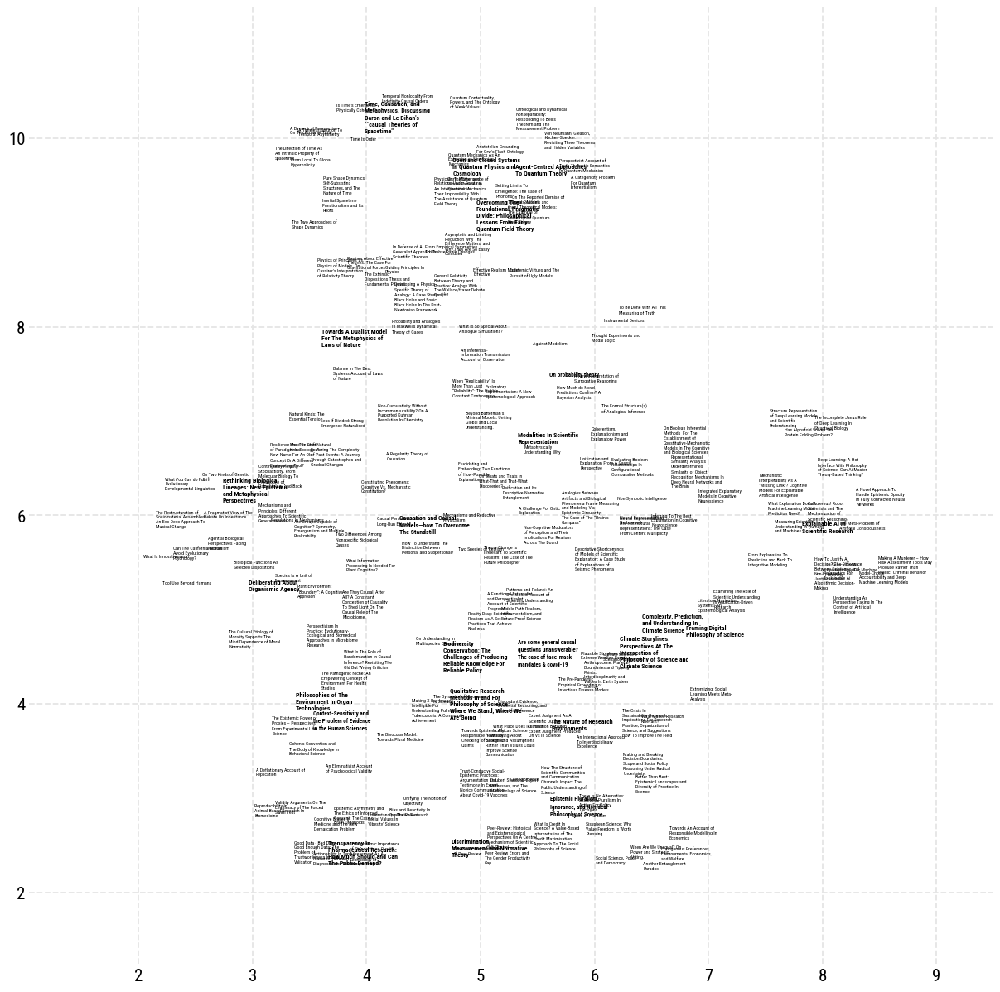

In [94]:


def plot_texts(ax, text_data,coordinates):
    ax.scatter(coordinates['x'], coordinates['y'], s=20, alpha=0, c='#a7510f')
    texts = []
    for i, row in text_data.iterrows():
        texts.append(ax.text(coordinates['x'][i], coordinates['y'][i], textwrap.fill(row['title'], 25),
                             fontsize=row['fontsize'], ma='left', fontweight=row['fontweight'], zorder=10))

def plot_texts_to_gif(text_data,data_list, n, output_filename):
    temp_dir = 'images/temp'
    os.makedirs(temp_dir, exist_ok=True)  # Create the temporary directory
    
    selected_indices = np.linspace(0, len(data_list) - 1, n, dtype=int)
    images = []

    for i in tqdm.tqdm_notebook(selected_indices):
        fig, ax = plt.subplots(figsize=(15,15))
        plot_texts(ax, text_data,data_list[i])
        # ax.axis('off')
        ax.set_xlim([data_list[i]['x'].min() - 1, data_list[i]['x'].max() + 1])
        ax.set_ylim([data_list[i]['y'].min() - 1, data_list[i]['y'].max() + 1])
        plt.tight_layout()
        
        img_path = os.path.join(temp_dir, f'temp_{i}.png')
        plt.savefig(img_path)
        plt.close(fig)
        
        images.append(imageio.imread(img_path))

    # Create GIF
    imageio.mimsave(output_filename, images, duration=14, loop=0)
    
    # Clean up: delete the temporary directory and its contents
    shutil.rmtree(temp_dir)

# Example usage
# data_list = [Your list of dataframes each with 'x', 'y', 'title', 'fontsize', 'fontweight' columns]
plot_texts_to_gif(data,optimization_progress_texts + [rectangles_adjusted],n=150, output_filename='images/layout_process_texts.gif')


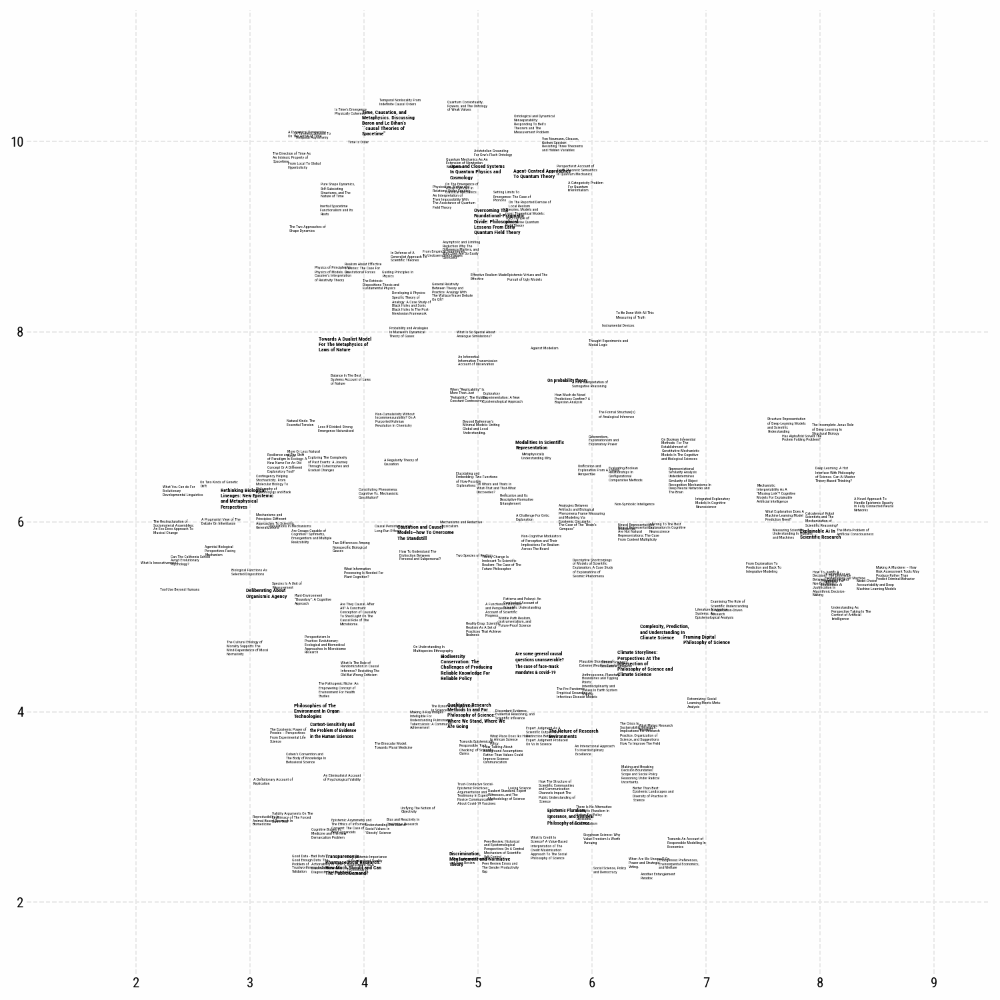

In [83]:
display(Image(filename='images/layout_process_texts.gif'))


## Adjust rectangles directly
We load some example data of images layed out with UMAP. (Were going to visualize them with vikus-viewer later...)

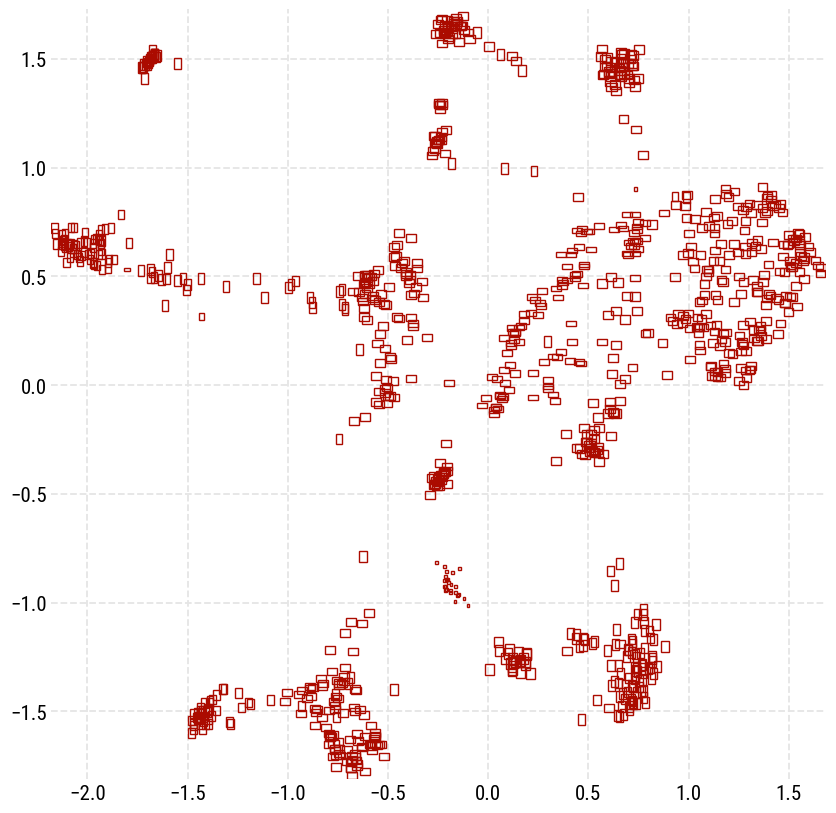

In [43]:
data = pd.read_csv("data/vsz_image_map.csv")


fig, ax = plt.subplots(figsize=(10,10))
plot_rectangles(ax,data,color= '#ab0b00')
plt.show()

In [28]:
rectangles_adjusted, optimization_process = adjust_labels(data,
                                  
                                  #  speed=.01,
                                    adjust_by_size=True,
                                    radius_scale=1.1,
                                    max_iterations=250,
                                    margin_percentage=5,
                                    return_optimization_process=True)


  0%|          | 0/250 [00:00<?, ?it/s]

100%|██████████| 250/250 [00:45<00:00,  5.49it/s]


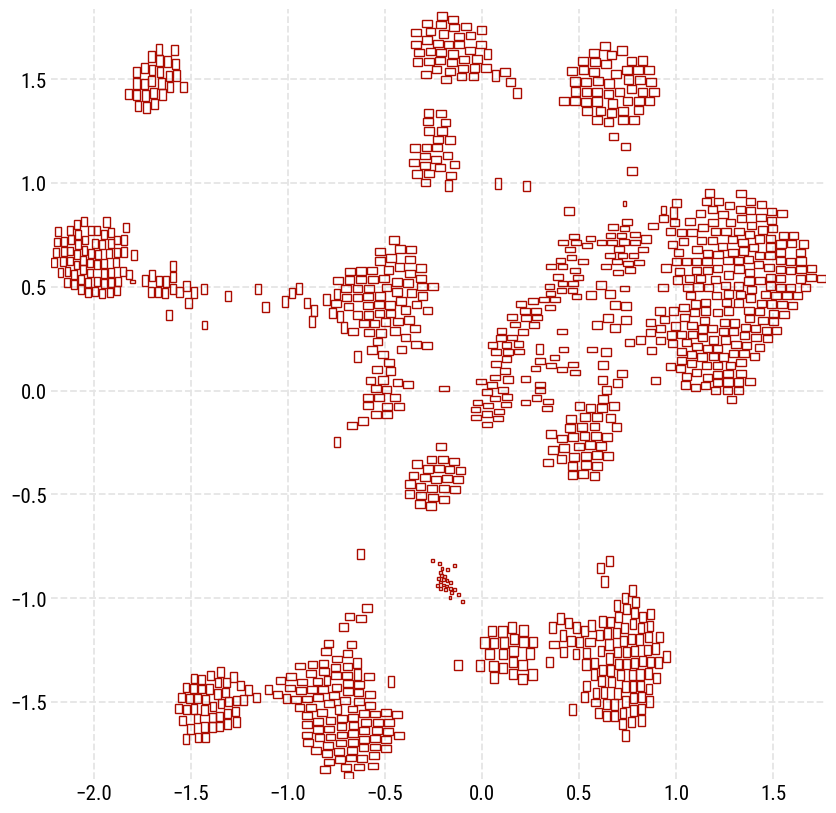

In [44]:


fig, ax = plt.subplots(figsize=(10,10))
plot_rectangles(ax,rectangles_adjusted,color= '#ab0b00')
plt.show()

In [84]:
import imageio

def plot_rectangles_to_gif(rectangles_adjusted_list, n, output_filename):
    temp_dir = 'images/temp'
    os.makedirs(temp_dir, exist_ok=True)  # Create the temporary directory
    
    selected_indices = np.linspace(0, len(rectangles_adjusted_list) - 1, n, dtype=int)
    images = []

    for i in tqdm.tqdm_notebook(selected_indices):
        fig, ax = plt.subplots(figsize=(10,10))
        plot_rectangles(ax, rectangles_adjusted_list[i],color= '#ab0b00')
        # plt.axis('off')
        plt.tight_layout()
        ax.set_xlim([rectangles_adjusted_list[i]['x'].min() - .3, rectangles_adjusted_list[i]['x'].max() + .3])
        ax.set_ylim([rectangles_adjusted_list[i]['y'].min() - .3, rectangles_adjusted_list[i]['y'].max() + .3])
        img_path = os.path.join(temp_dir, f'temp_{i}.png')  # Use os.path.join for path construction
        plt.savefig(img_path)
        plt.close(fig)
        
        images.append(imageio.imread(img_path))

    # Create GIF
    imageio.mimsave(output_filename, images, duration=14, loop=0)
    
    # Clean up: delete the temporary directory and its contents
    shutil.rmtree(temp_dir)


# Example usage
plot_rectangles_to_gif(optimization_process+[rectangles_adjusted], n=100, output_filename='images/layout_process_rectangles.gif')


/var/folders/hz/4s_tpd8s47xfzz7rhhfjdbb00000gn/T/ipykernel_86221/933536859.py:10: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i in tqdm.tqdm_notebook(selected_indices):


  0%|          | 0/100 [00:00<?, ?it/s]

/var/folders/hz/4s_tpd8s47xfzz7rhhfjdbb00000gn/T/ipykernel_86221/933536859.py:21: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(img_path))


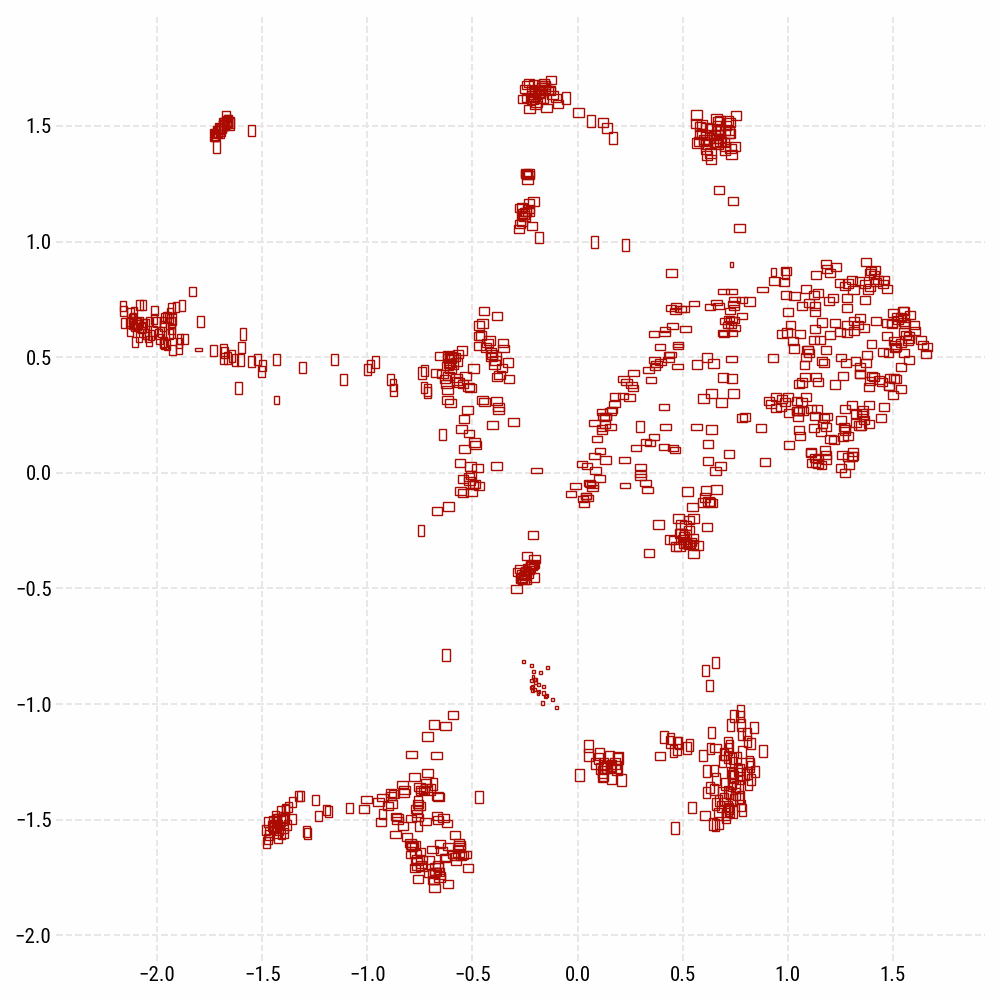

In [85]:

display(Image(filename='images/layout_process_rectangles.gif'))
